<a href="https://colab.research.google.com/github/FatimaJahara/ComplexityT2I/blob/main/test_complexity_2_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install diffusers==0.18.0
!pip install transformers scipy ftfy
!pip install "ipywidgets>=7,<8"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 20.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 22.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 54.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 63.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 76.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 22.1 MB/s eta 0:00:00


In [ ]:
import torch
from diffusers import StableDiffusionPipeline
from PIL import Image

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
# model21 = "stabilityai/stable-diffusion-2-1"
model15 = "runwayml/stable-diffusion-v1-5"

# pipe21 = StableDiffusionPipeline.from_pretrained(model21)
pipe15 = StableDiffusionPipeline.from_pretrained(model15)

# pipe21 = pipe21.to("cuda")
pipe15 = pipe15.to("cuda")

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [ ]:
def image_grid(imgs, rows=2, cols=2):
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

def get_inputs(prompt, batch_size=1):
  generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
  prompts = batch_size * [prompt]
  num_inference_steps = 20

  return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}

In [ ]:
prompts = ["A cat",
           "A photo of a cat",
           "A photo of a cat with green eyes",
           "A photo of a cat with green eyes sitting",
           "A photo of a cat with green eyes sitting on a red pillow",
           "A photo of a cat with green eyes sitting on a red pillow near a window",
           "A photo of a cat with green eyes sitting on a red pillow near a window, with two rats",
           "A photo of a cat with green eyes sitting on a red pillow near a window, with two rats playing ball",
           "A photo of a cat with green eyes sitting on a red mat near a window, with two rats playing ball. A bowl of milk is placed nearby."]

image_set = []
for prompt in prompts:
    images = pipe15(**get_inputs(prompt, batch_size=5)).images
    image_set.append(images)
    image_grid(images, rows=1, cols=5)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
import numpy as np
from PIL import Image

def calculate_l2_norm(image1, image2):
    # Convert PIL Images to numpy arrays
    array1 = np.array(image1)
    array2 = np.array(image2)
    l2_norm = np.sqrt(np.sum(np.power((array1-array2),2)))
    return l2_norm

In [ ]:
# Calculate the L2 norm for each pair of images

l2_norm = [[],[],[],[],[],[],[],[]]
for i in range(5):
    l2_norm[0].append(calculate_l2_norm(image_set[0][i], image_set[1][i]))
    l2_norm[1].append(calculate_l2_norm(image_set[0][i], image_set[2][i]))
    l2_norm[2].append(calculate_l2_norm(image_set[0][i], image_set[3][i]))
    l2_norm[3].append(calculate_l2_norm(image_set[0][i], image_set[4][i]))
    l2_norm[4].append(calculate_l2_norm(image_set[0][i], image_set[5][i]))
    l2_norm[5].append(calculate_l2_norm(image_set[0][i], image_set[6][i]))
    l2_norm[6].append(calculate_l2_norm(image_set[0][i], image_set[7][i]))
    l2_norm[7].append(calculate_l2_norm(image_set[0][i], image_set[8][i]))

flat_l2_norm = [norm for sublist in l2_norm for norm in sublist]
min_value = np.min(flat_l2_norm)
max_value = np.max(flat_l2_norm)

# Normalize the L2 norms
l2_norm_normalized = [[(val - min_value) / (max_value - min_value) for val in sublist] for sublist in l2_norm]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def l2_norm_group_bar(l2_norms_complexity):

    image_pairs = ["Pair 1", "Pair 2", "Pair 3", "Pair 4", "Pair 5"]  # And these with your actual image pair names
    complexities = ["1-2", "1-3", "1-4", "1-5", "1-6", "1-7", "1-8", "1-9"]

# The number of complexities
    N = len(complexities)

# The x locations for the groups
    ind = np.arange(N)

# The width of the bars
    width = 0.1

# Create a figure and a set of subplots
    fig, ax = plt.subplots()

    for i in range(len(image_pairs)):
        ax.bar(ind + i*width, [l2[i] for l2 in l2_norms_complexity], width, label=image_pairs[i])

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_xlabel('Complexity')
    # ax.set_ylabel('Normalized L2 Norm')
    # ax.set_title('Normalized L2 Norms by complexity and fixed-seed image pairs')
    ax.set_ylabel('L2 Norm')
    ax.set_title('L2 Norms by complexity and image pairs')
    ax.set_xticks(ind + width / 2)
    ax.set_xticklabels(complexities)
    # ax.legend()

    # Show the plot
    plt.show()

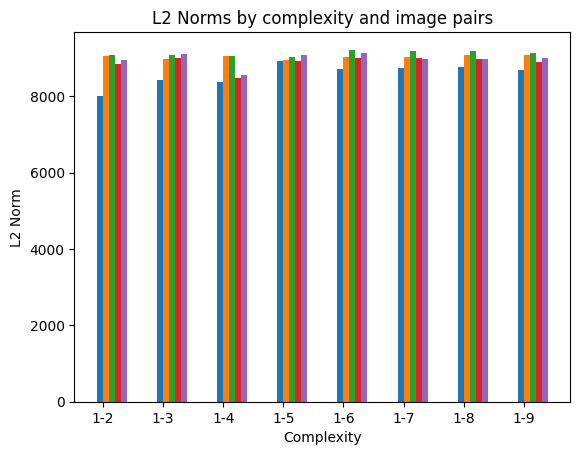

In [ ]:
l2_norm_group_bar(l2_norm)

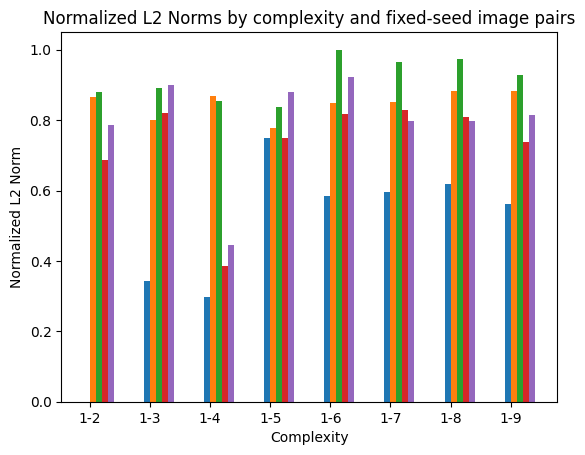

In [ ]:
l2_norm_group_bar(l2_norm_normalized)

In [ ]:
l2_norm2 = [[],[],[],[],[],[],[],[]]
for i in range(5):
    l2_norm2[0].append(calculate_l2_norm(image_set[0][i], image_set[1][i]))
    l2_norm2[1].append(calculate_l2_norm(image_set[1][i], image_set[2][i]))
    l2_norm2[2].append(calculate_l2_norm(image_set[2][i], image_set[3][i]))
    l2_norm2[3].append(calculate_l2_norm(image_set[3][i], image_set[4][i]))
    l2_norm2[4].append(calculate_l2_norm(image_set[4][i], image_set[5][i]))
    l2_norm2[5].append(calculate_l2_norm(image_set[5][i], image_set[6][i]))
    l2_norm2[6].append(calculate_l2_norm(image_set[6][i], image_set[7][i]))
    l2_norm2[7].append(calculate_l2_norm(image_set[7][i], image_set[8][i]))

flat_l2_norm2 = [norm for sublist in l2_norm2 for norm in sublist]
min_value2 = np.min(flat_l2_norm2)
max_value2 = np.max(flat_l2_norm2)

# Normalize the L2 norms
l2_norm_normalized2 = [[(val - min_value2) / (max_value2 - min_value2) for val in sublist] for sublist in l2_norm2]

In [ ]:
l2_norm[0]

[8011.417852040923,
 9061.751541506752,
 9078.099470704206,
 8846.42040601734,
 8965.158894297412]

In [ ]:
l2_norm2[0]

[8011.417852040923,
 9061.751541506752,
 9078.099470704206,
 8846.42040601734,
 8965.158894297412]

In [ ]:
l2_norm_normalized[0]

[0.0,
 0.8654223206223021,
 0.8788921949730195,
 0.6880002567139681,
 0.7858348202485195]

In [ ]:
l2_norm_normalized2[0]

[0.6365010974392804,
 0.9833025411071512,
 0.9887003356399922,
 0.9122040422173852,
 0.9514093724543045]

In [ ]:
def l2_norm_group_bar2(l2_norms_complexity):

    image_pairs = ["Pair 1", "Pair 2", "Pair 3", "Pair 4", "Pair 5"]  # And these with your actual image pair names
    # complexities = ["1-2", "1-3", "1-4", "1-5", "1-6", "1-7", "1-8", "1-9"]
    complexities = ["1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9"]

# The number of complexities
    N = len(complexities)

# The x locations for the groups
    ind = np.arange(N)

# The width of the bars
    width = 0.1

# Create a figure and a set of subplots
    fig, ax = plt.subplots()

    for i in range(len(image_pairs)):
        ax.bar(ind + i*width, [l2[i] for l2 in l2_norms_complexity], width, label=image_pairs[i])

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_xlabel('Complexity')
    # ax.set_ylabel('Normalized L2 Norm')
    # ax.set_title('Normalized L2 Norms by complexity and fixed-seed image pairs')
    ax.set_ylabel('L2 Norm')
    ax.set_title('L2 Norms by complexity and image pairs')
    ax.set_xticks(ind + width / 2)
    ax.set_xticklabels(complexities)
    # ax.legend()

    # Show the plot
    plt.show()

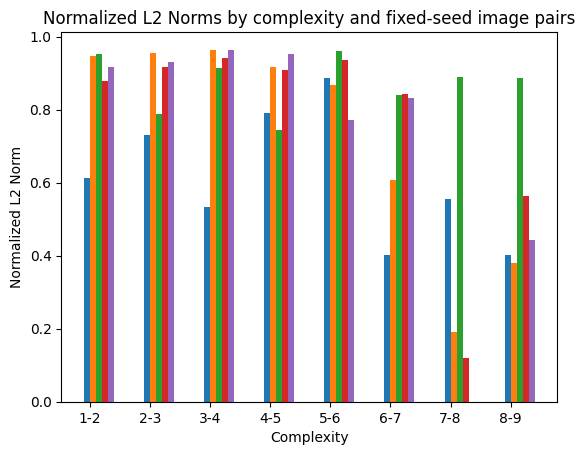

In [ ]:
l2_norm_group_bar2(l2_norm_normalized2)

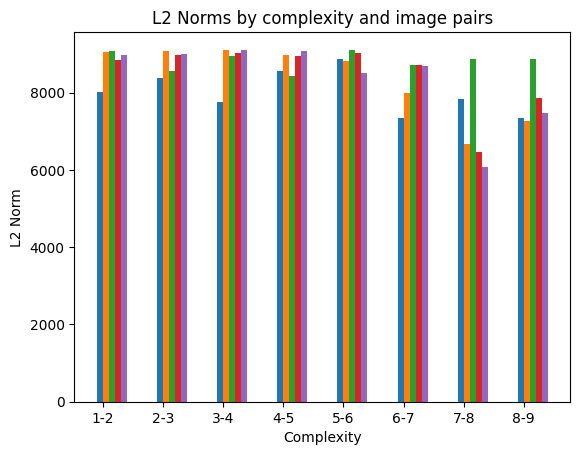

In [ ]:
l2_norm_group_bar2(l2_norm2)

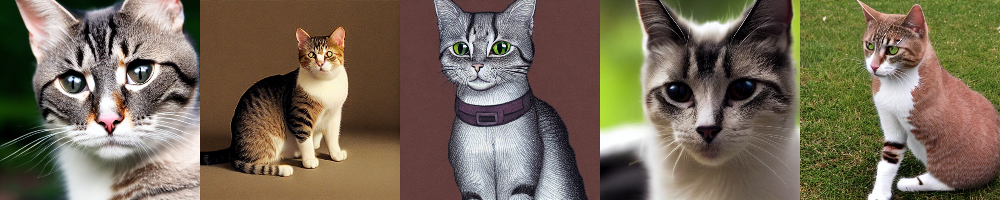

In [ ]:
image_grid(image_set[0], rows=1, cols=5)

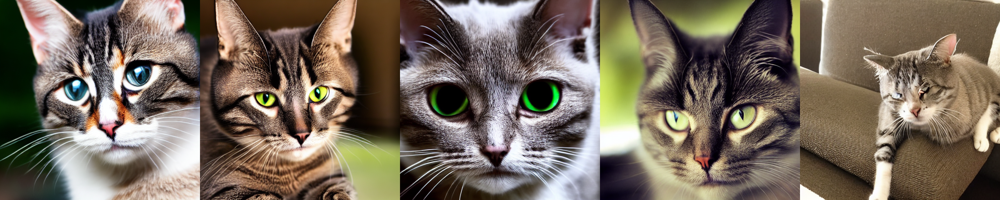

In [ ]:
image_grid(image_set[1], rows=1, cols=5)

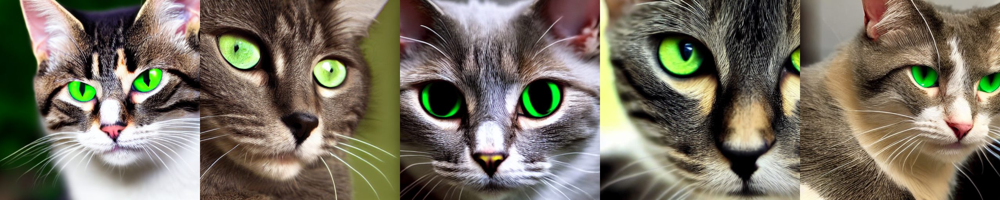

In [ ]:
image_grid(image_set[2], rows=1, cols=5)

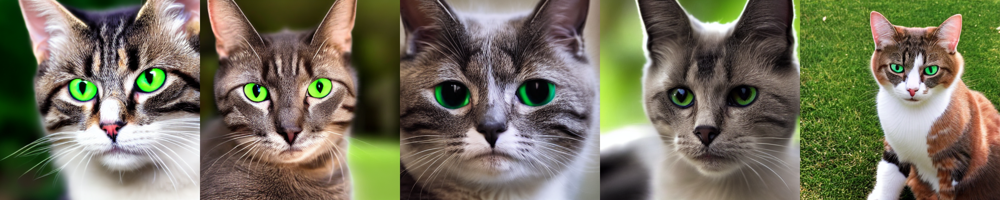

In [ ]:
image_grid(image_set[3], rows=1, cols=5)

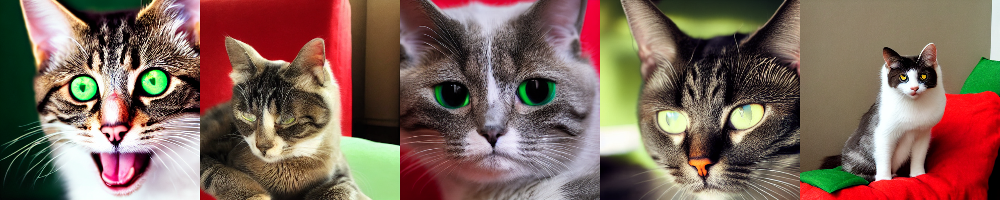

In [ ]:
image_grid(image_set[4], rows=1, cols=5)

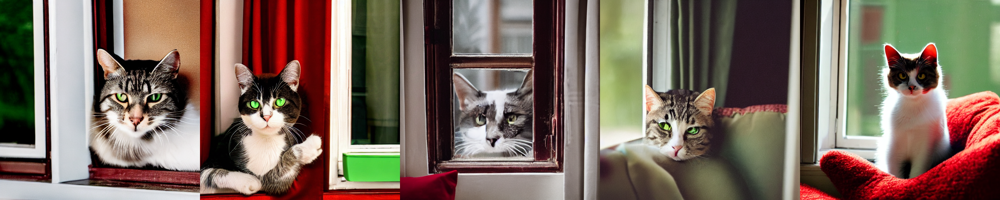

In [ ]:
image_grid(image_set[5], rows=1, cols=5)

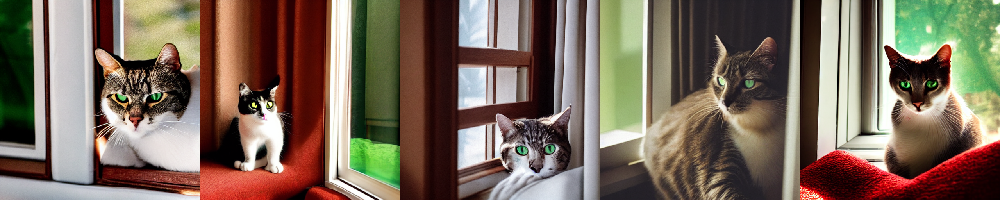

In [ ]:
image_grid(image_set[6], rows=1, cols=5)

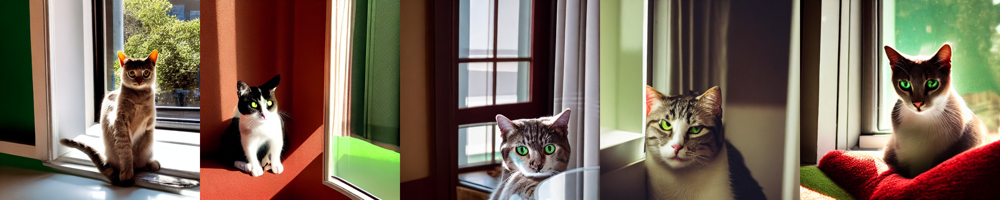

In [ ]:
image_grid(image_set[7], rows=1, cols=5)

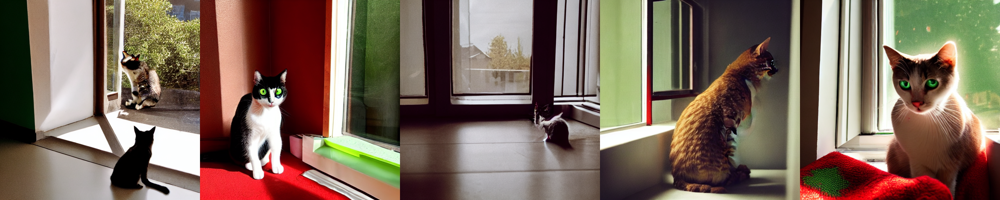

In [ ]:
image_grid(image_set[8], rows=1, cols=5)

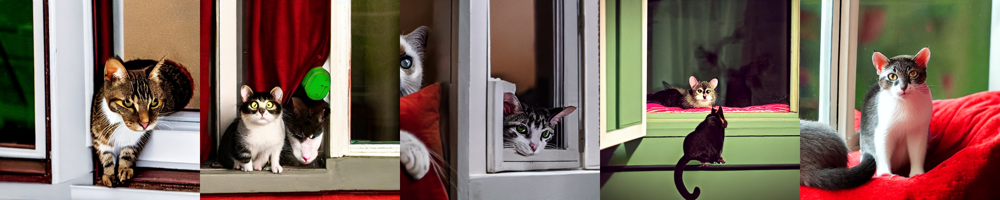

In [ ]:
image_grid(image_set[6], rows=1, cols=5)

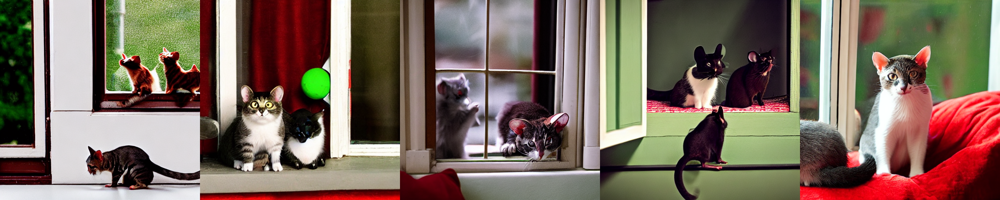

In [ ]:
image_grid(image_set[7], rows=1, cols=5)

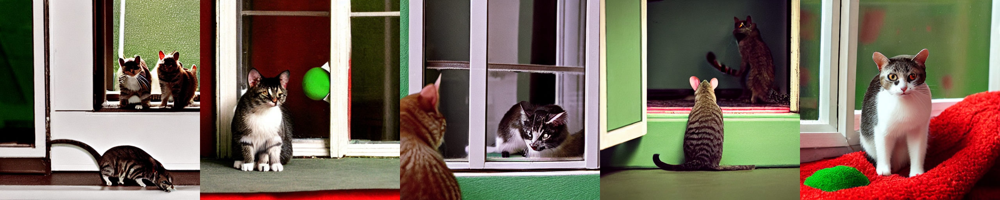

In [ ]:
image_grid(image_set[8], rows=1, cols=5)

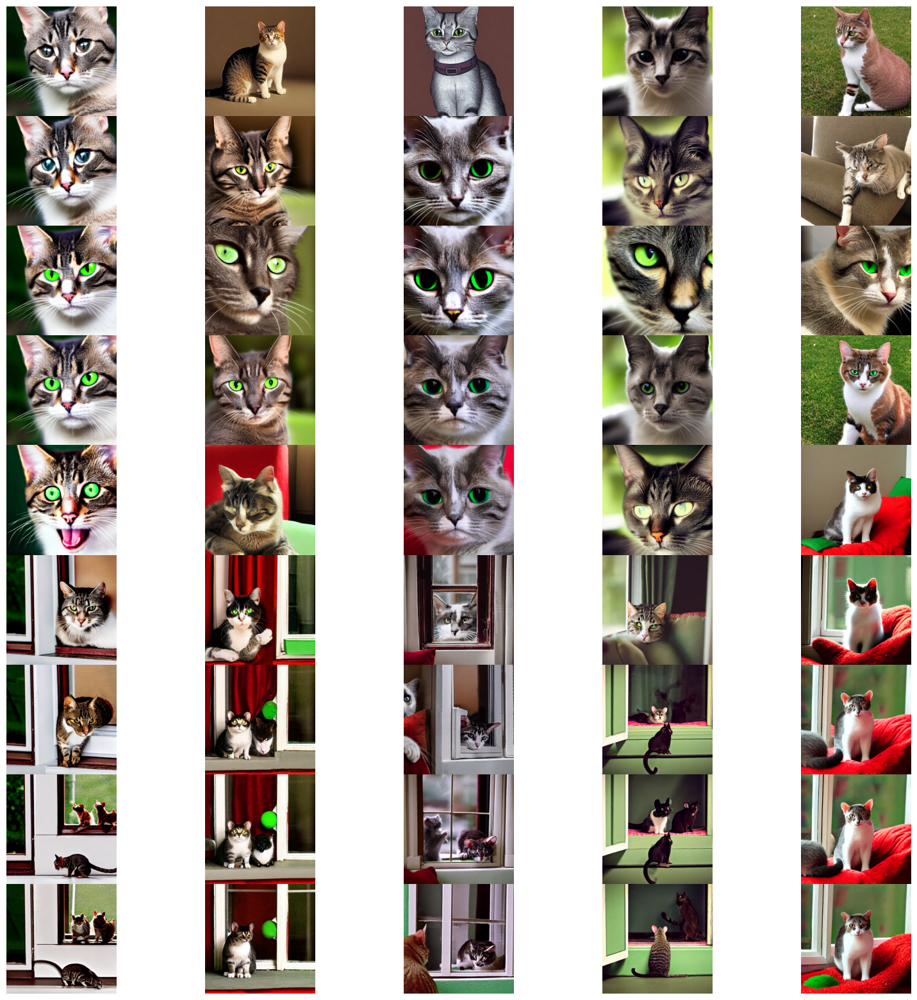

In [ ]:
import matplotlib.pyplot as plt

# List of list of images
your_list_of_images = image_set

# Create figure with sub-plots.
fig, axes = plt.subplots(len(your_list_of_images), len(your_list_of_images[0]), figsize=(20, 20))

# Iterate over the sub-plots and show images.
for i, row in enumerate(axes):
    for j, ax in enumerate(row):
        ax.imshow(your_list_of_images[i][j])
        ax.axis('off')  # to remove the axis of image sub-plots

# Remove the spaces between subplots
plt.subplots_adjust(wspace=0, hspace=0)

plt.show()

In [ ]:
import pandas as pd

df = pd.DataFrame(l2_norm)
df

,0,1,2,3,4
0,8011.417852,9061.751542,9078.099471,8846.420406,8965.158894
1,8426.057975,8983.178669,9093.097327,9005.233312,9104.367743
2,8371.061701,9065.084721,9047.824324,8477.857041,8551.321652
3,8922.387461,8955.121775,9029.168733,8920.515120,9077.840547
4,8719.661691,9040.379749,9225.083902,9004.477942,9129.412522
5,8733.889111,9046.057373,9183.820338,9018.067753,8978.287587
6,8763.578778,9081.497949,9193.255571,8991.647569,8980.260074
7,8691.704033,9081.679305,9139.369070,8906.789264,8999.579046


In [ ]:
import pandas as pd

image_names = ['image12', 'image13', 'image14', 'image15', 'image16', 'image17', 'image18', 'image19']
seed_names = ['pair1', 'pair2', 'pair3', 'pair4', 'pair5',]
df = pd.DataFrame(l2_norm, columns=seed_names, index=image_names)

In [ ]:
df

,pair1,pair2,pair3,pair4,pair5
image12,8011.417852,9061.751542,9078.099471,8846.420406,8965.158894
image13,8426.057975,8983.178669,9093.097327,9005.233312,9104.367743
image14,8371.061701,9065.084721,9047.824324,8477.857041,8551.321652
image15,8922.387461,8955.121775,9029.168733,8920.515120,9077.840547
image16,8719.661691,9040.379749,9225.083902,9004.477942,9129.412522
image17,8733.889111,9046.057373,9183.820338,9018.067753,8978.287587
image18,8763.578778,9081.497949,9193.255571,8991.647569,8980.260074
image19,8691.704033,9081.679305,9139.369070,8906.789264,8999.579046


In [ ]:
import pandas as pd

image_names = ['image12', 'image23', 'image34', 'image45', 'image56', 'image67', 'image78', 'image89']
seed_names = ['pair1', 'pair2', 'pair3', 'pair4', 'pair5',]
df2 = pd.DataFrame(l2_norm2, columns=seed_names, index=image_names)
df2

,pair1,pair2,pair3,pair4,pair5
image12,8011.417852,9061.751542,9078.099471,8846.420406,8965.158894
image23,8380.270222,9084.477200,8561.443745,8966.066083,9009.213950
image34,7757.007864,9111.080616,8952.682280,9039.384658,9112.321987
image45,8565.312954,8967.475397,8420.465486,8937.130971,9079.230199
image56,8872.017696,8812.732153,9102.570461,9024.720106,8507.069648
image67,7344.218883,7991.345068,8720.648886,8727.381108,8694.331889
image78,7830.259383,6681.436747,8879.373852,6463.050828,6083.690738
image89,7347.427577,7277.235876,8870.299149,7857.644367,7471.038884


In [ ]:
(df.mean()).mean()

8922.5366222942

  0%|          | 0/20 [00:00<?, ?it/s]

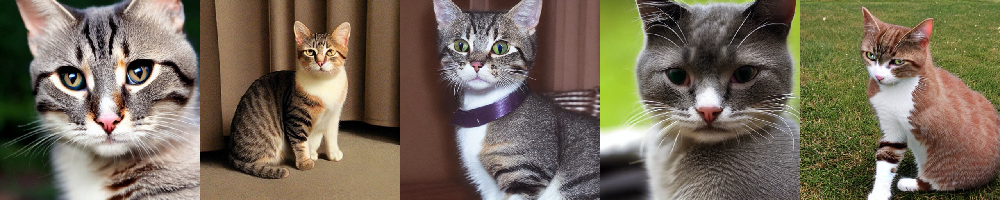

In [ ]:
prompt = "cat"
image1 = pipe15(**get_inputs(prompt, batch_size=5)).images
image_grid(image1, rows=1, cols=5)


  0%|          | 0/20 [00:00<?, ?it/s]

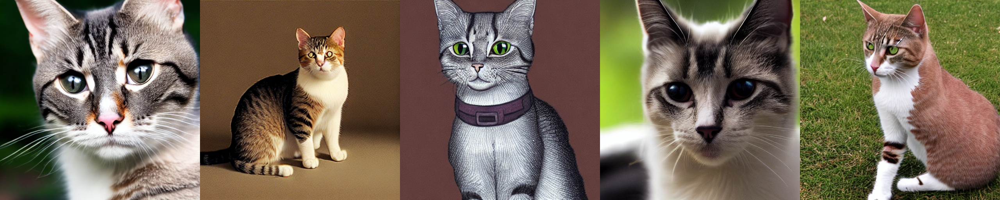

In [ ]:
prompt = "a cat"
image2 = pipe15(**get_inputs(prompt, batch_size=5)).images
image_grid(image2, rows=1, cols=5)

In [ ]:
def calculate_l2_norm(image1, image2):
    # Convert PIL Images to numpy arrays
    array1 = np.array(image1)
    array2 = np.array(image2)
    l2_norm = np.sqrt(np.sum(np.power((array1-array2),2)))
    return l2_norm

for i in range(5):
    print(calculate_l2_norm(image1[i], image2[i]))

7795.366380100425
8557.294315377963
8593.063888974642
8574.511006465616
7224.674940784534
